## Spatial Autocorrelation

### Methodology

1. import census block group boundaries for Los Angeles
1. import bicycle crash data (soure: TIMS)
1. spatially join the two datasets
1. normalize the data to create crashes per 1000
1. conduct [global spatial autocorrelation](https://geographicdata.science/book/notebooks/06_spatial_autocorrelation.html) using Moran's I
1. conduct [local spatial autocorrelation](https://geographicdata.science/book/notebooks/07_local_autocorrelation.html) using Local Indicators of Spatial Association (LISAs)

In [1]:
# to read data
import pandas as pd

# to create spatial data
import geopandas as gpd

# for basemaps
import contextily as ctx

# For spatial statistics
import esda
from esda.moran import Moran, Moran_Local

import splot
from splot.esda import moran_scatterplot, plot_moran, lisa_cluster,plot_moran_simulation

import libpysal as lps

# Graphics
import matplotlib.pyplot as plt
import plotly.express as px

/opt/conda/lib/python3.9/site-packages/geopandas/_compat.py:106: UserWarning: The Shapely GEOS version (3.9.1-CAPI-1.14.2) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(


In [2]:
# to illustrate, bring in tracts
gdf_tracts = gpd.read_file('tracts.geojson')

In [3]:
# population block group data from census reporter
gdf_bg = gpd.read_file('acs2019_5yr_B01003_15000US060372672002.geojson')

<AxesSubplot:>

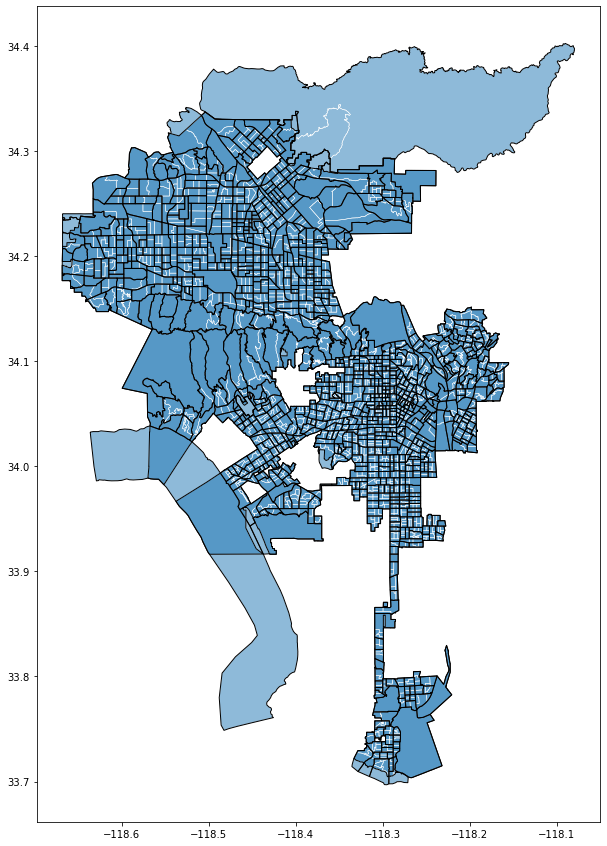

In [4]:
# compare
fig,ax = plt.subplots(figsize=(15,15))

# blue background of census tracts
gdf_tracts.plot(ax=ax,zorder=10,alpha=0.5)

# while lines to show block groups (sandwiched between the two layers above for visual clarity)
gdf_bg.boundary.plot(ax=ax,color='white',zorder=15,lw=0.5)

# black boundary lines of census tracts on top of everything
gdf_tracts.boundary.plot(ax=ax,color='black',zorder=20,lw=1)

In [5]:
# get the total bounds
minx,miny,maxx,maxy = gdf_bg.total_bounds

## Data cleanup

In [6]:
gdf_bg.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 2516 entries, 0 to 2515
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   geoid             2516 non-null   object  
 1   name              2516 non-null   object  
 2   B01003001         2516 non-null   float64 
 3   B01003001, Error  2516 non-null   float64 
 4   geometry          2516 non-null   geometry
dtypes: float64(2), geometry(1), object(2)
memory usage: 98.4+ KB


In [7]:
# trim the data to the bare minimum columns
gdf_bg = gdf_bg[['geoid','B01003001','geometry']]

# rename the columns
gdf_bg.columns = ['FIPS','TotalPop','geometry']

In [8]:
# last rows
gdf_bg.tail()

,FIPS,TotalPop,geometry
2511,15000US060379800261,26.0,"MULTIPOLYGON (((-118.35173 34.28034, -118.3517..."
2512,15000US060379800281,0.0,"MULTIPOLYGON (((-118.45246 33.94315, -118.4464..."
2513,15000US060379800311,1175.0,"MULTIPOLYGON (((-118.29105 33.75378, -118.2905..."
2514,15000US060379902000,0.0,"MULTIPOLYGON (((-118.63598 34.03255, -118.6325..."
2515,16000US0644000,3966936.0,"MULTIPOLYGON (((-118.66818 34.18987, -118.6681..."


In [9]:
# delete last row which is for the entire city of LA
gdf_bg=gdf_bg.drop(2515)

In [10]:
# fix FIPS code
gdf_bg['FIPS'] = gdf_bg['FIPS'].str.replace('15000US','')
gdf_bg.tail()

,FIPS,TotalPop,geometry
2510,060379800241,223.0,"MULTIPOLYGON (((-118.51849 34.18389, -118.5184..."
2511,060379800261,26.0,"MULTIPOLYGON (((-118.35173 34.28034, -118.3517..."
2512,060379800281,0.0,"MULTIPOLYGON (((-118.45246 33.94315, -118.4464..."
2513,060379800311,1175.0,"MULTIPOLYGON (((-118.29105 33.75378, -118.2905..."
2514,060379902000,0.0,"MULTIPOLYGON (((-118.63598 34.03255, -118.6325..."


One more data cleanup: get rid of census blocks groups with less than 100 total population.

In [11]:
# sort by total pop
gdf_bg.sort_values(by='TotalPop').head(20)

,FIPS,TotalPop,geometry
2514,060379902000,0.0,"MULTIPOLYGON (((-118.63598 34.03255, -118.6325..."
2358,060372772002,0.0,"MULTIPOLYGON (((-118.38597 33.94734, -118.3859..."
2512,060379800281,0.0,"MULTIPOLYGON (((-118.45246 33.94315, -118.4464..."
2509,060379800231,0.0,"MULTIPOLYGON (((-118.64870 34.23120, -118.6480..."
2506,060379800201,0.0,"MULTIPOLYGON (((-118.34412 34.21700, -118.3438..."
2508,060379800221,0.0,"MULTIPOLYGON (((-118.50266 34.30809, -118.5026..."
2501,060379800091,5.0,"MULTIPOLYGON (((-118.33707 34.14160, -118.3361..."
2503,060379800141,9.0,"MULTIPOLYGON (((-118.26088 33.76850, -118.2602..."
2511,060379800261,26.0,"MULTIPOLYGON (((-118.35173 34.28034, -118.3517..."
2507,060379800211,33.0,"MULTIPOLYGON (((-118.40183 34.26509, -118.4017..."


In [12]:
# delete less than 100 population geographies
gdf_bg = gdf_bg[gdf_bg['TotalPop']>100]

## Mapping the census block groups

In [13]:
# get the layers into a web mercator projection
# reproject to web mercator
gdf_bg = gdf_bg.to_crs(epsg=3857)

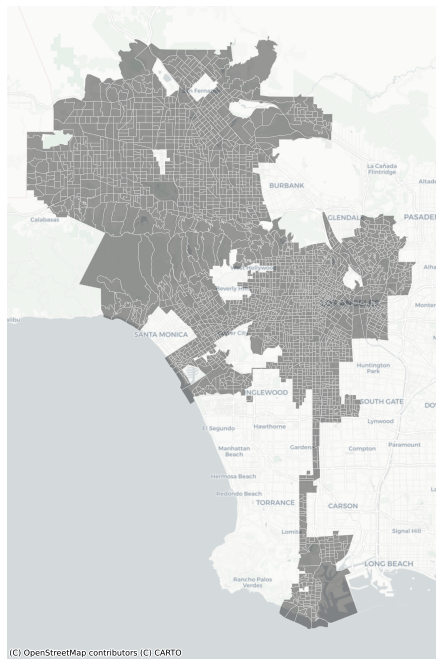

In [14]:
# plot it!
fig, ax = plt.subplots(figsize=(12,12))

gdf_bg.plot(ax=ax,
         color='black', 
         edgecolor='white',
         lw=0.5,
         alpha=0.4)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

In [15]:
df = pd.read_csv('Crashes_2009_2018.csv')

In [16]:
sub = ['ACCIDENT_YEAR', 'COLLISION_SEVERITY', 'POINT_X', 'POINT_Y']

In [17]:
crash = df[sub].copy()

### Convert data to a geodataframe


In [18]:
crashes = gpd.GeoDataFrame(crash,
                              crs='EPSG:4326',
                              geometry=gpd.points_from_xy(crash.POINT_X, crash.POINT_Y))

In [19]:
# get the layers into a web mercator projection
# reproject to web mercator
crashes = crashes.to_crs(epsg=3857)

In [20]:
# convert lat/lon to floats
crashes.POINT_X = crashes.POINT_X.astype('float')
crashes.POINT_Y = crashes.POINT_Y.astype('float')

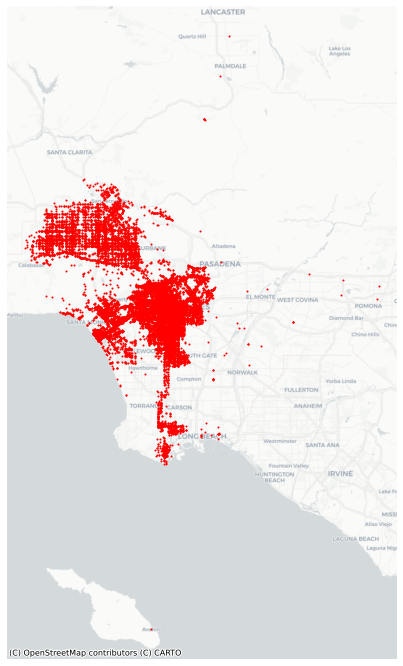

In [21]:
# map it!
fig,ax = plt.subplots(figsize=(12,12))

crashes.plot(ax=ax,
             color='red',
             markersize=1)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)


### More cleaning
There are crash data points outside of the city of Los Angeles, so let's subset the data.

In [22]:
# subset the records east of the city
crashes[crashes.POINT_X>-118.1]

,ACCIDENT_YEAR,COLLISION_SEVERITY,POINT_X,POINT_Y,geometry
711,2009,4,-118.068976,33.971328,POINT (-13143378.276 4024952.779)
780,2009,3,-118.093830,34.005800,POINT (-13146145.021 4029580.851)
911,2009,3,-118.068900,33.971335,POINT (-13143369.860 4024953.600)
1063,2009,4,-118.035030,33.967290,POINT (-13139599.435 4024410.718)
1682,2009,4,-117.951460,34.020155,POINT (-13130296.488 4031508.726)
1694,2009,4,-117.723360,34.099710,POINT (-13104904.490 4042198.514)
3890,2011,4,-118.068917,33.971308,POINT (-13143371.719 4024950.007)
4260,2011,4,-117.951472,34.020373,POINT (-13130297.812 4031537.985)
4860,2011,3,-117.951460,34.020160,POINT (-13130296.466 4031509.343)
11884,2014,4,-118.067520,33.925923,POINT (-13143216.206 4018859.613)


In [23]:
# subset the records north of the city
crashes[crashes.POINT_Y>34.4]

,ACCIDENT_YEAR,COLLISION_SEVERITY,POINT_X,POINT_Y,geometry
171,2009,4,-118.185327,34.464011,POINT (-13156330.421 4091278.832)
291,2009,3,-118.184840,34.462200,POINT (-13156276.208 4091034.333)
351,2009,3,-118.185129,34.464964,POINT (-13156308.413 4091407.503)
508,2009,3,-118.185112,34.464715,POINT (-13156306.443 4091373.868)
4576,2011,3,-118.185093,34.464450,POINT (-13156304.361 4091338.145)
14286,2015,3,-118.120990,34.645890,POINT (-13149168.459 4115862.531)
21513,2019,4,-118.142723,34.557991,POINT (-13151587.776 4103974.951)


In [24]:
crashes.drop(crashes[crashes.POINT_X>-118.1].index,inplace=True)
crashes.drop(crashes[crashes.POINT_Y>34.4].index,inplace=True)

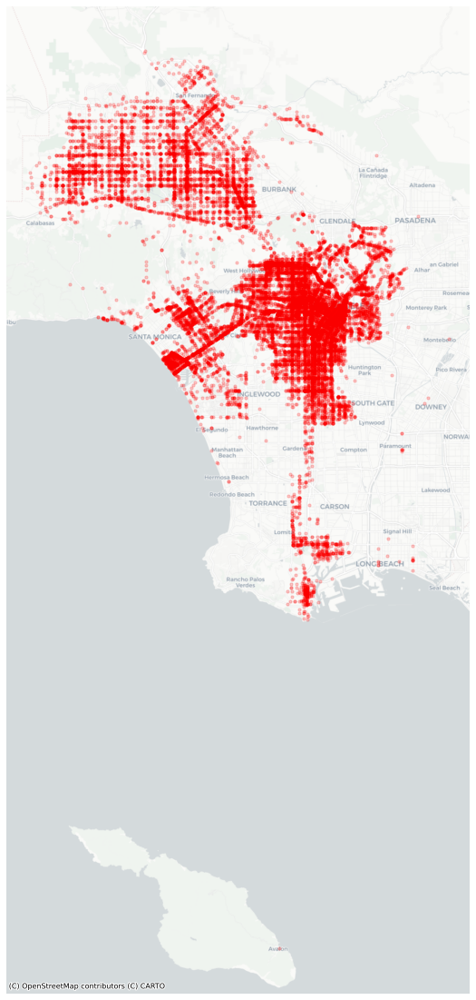

In [25]:
# map it!
fig,ax = plt.subplots(figsize=(20,20))

crashes.plot(ax=ax,
             color='red',
             markersize=10, alpha=0.2)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)


## Creating a two layer map

In [26]:
# get the bounding box coordinates for the arrest data
minx, miny, maxx, maxy = crashes.geometry.total_bounds
print(minx)
print(maxx)
print(miny)
print(maxy)

-13209317.84170913
-13146852.924333269
3940829.8655812414
4073773.185991595


## Subplots for multi-layered maps

We're using subplots to layer our maps on top of one another.

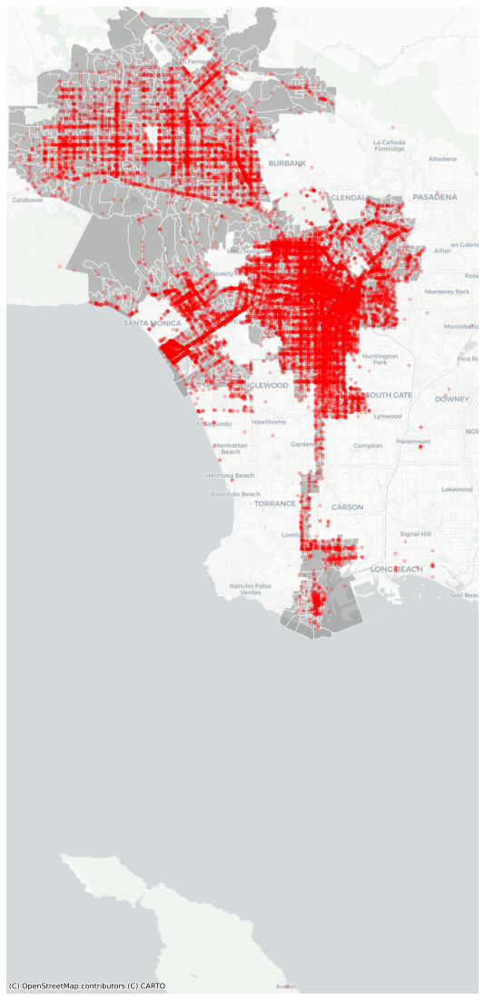

In [28]:
# set up the plot canvas with plt.subplots
fig, ax = plt.subplots(figsize=(20, 20))

# block groups
gdf_bg.plot(ax=ax, # this puts it in the ax plot
        color='gray', 
        edgecolor='white',
        alpha=0.5)

# crashes
crashes.plot(ax=ax, # this also puts it in the same ax plot
            color='red',
            markersize=10,
            alpha=0.2)

# use the bounding box coordinates to set the x and y limits
ax.set_xlim(minx - 1000, maxx + 1000) # added/substracted value is to give some margin around total bounds
ax.set_ylim(miny - 1000, maxy + 1000)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

## The spatial join

In [29]:
# Do the spatial join
join = gpd.sjoin(crashes, gdf_bg, how='left')
join.head()

,ACCIDENT_YEAR,COLLISION_SEVERITY,POINT_X,POINT_Y,geometry,index_right,FIPS,TotalPop
0,2009,3,-118.601602,34.206749,POINT (-13202669.964 4056597.295),687.0,060371345221,4167.0
1,2009,4,-118.310010,34.179690,POINT (-13170210.069 4052955.599),NaN,NaN,NaN
2,2009,3,-118.448752,34.172115,POINT (-13185654.758 4051936.331),586.0,060371288023,1114.0
3,2009,3,-118.536055,34.180725,POINT (-13195373.317 4053094.855),650.0,060371331002,1190.0
4,2009,4,-118.445609,34.059053,POINT (-13185304.847 4036734.141),2116.0,060372653051,3990.0


In [30]:
crashes_by_bg = join.FIPS.value_counts().rename_axis('FIPS').reset_index(name='crash_count')

In [31]:
crashes_by_bg.head()

,FIPS,crash_count
0,060372260021,267
1,060372077101,197
2,060372079001,125
3,060372240201,94
4,060372074001,88


<AxesSubplot:xlabel='FIPS'>

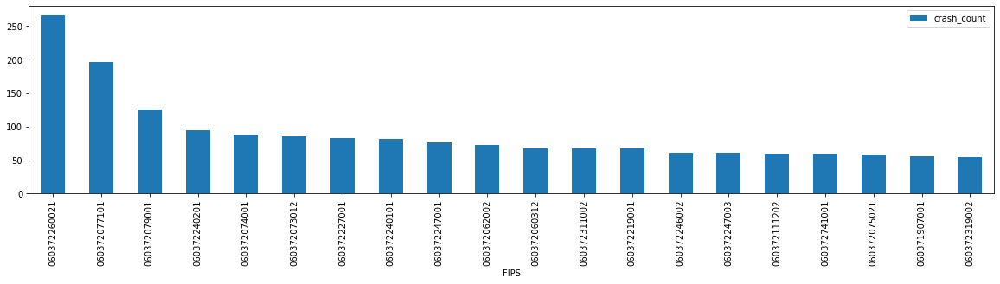

In [32]:
# make a bar chart of top 20 geographies
crashes_by_bg[:20].plot.bar(figsize=(20,4),
                             x='FIPS',
                             y='crash_count')

## Joining the value counts back to the gdf

In [33]:
# join the summary table back to the gdf
gdf_bg=gdf_bg.merge(crashes_by_bg,on='FIPS')

In [34]:
# our neighborhood table now has a count column
gdf_bg.sample(10)

,FIPS,TotalPop,geometry,crash_count
2184,060372771003,1156.0,"MULTIPOLYGON (((-13178613.689 4023422.738, -13...",8
864,060371881002,845.0,"MULTIPOLYGON (((-13165672.464 4046062.388, -13...",6
496,060371278053,1197.0,"MULTIPOLYGON (((-13186623.349 4054870.831, -13...",20
662,060371352012,866.0,"MULTIPOLYGON (((-13206062.292 4052942.815, -13...",6
34,060371041242,1532.0,"MULTIPOLYGON (((-13178633.058 4066743.143, -13...",3
986,060371926101,1459.0,"MULTIPOLYGON (((-13168574.118 4040030.576, -13...",19
796,060371831031,2107.0,"MULTIPOLYGON (((-13155969.412 4044014.184, -13...",2
1384,060372162005,2045.0,"MULTIPOLYGON (((-13175181.820 4036071.337, -13...",3
481,060371276032,1296.0,"MULTIPOLYGON (((-13189054.232 4055357.226, -13...",4
276,060371197002,2004.0,"MULTIPOLYGON (((-13183503.397 4058890.073, -13...",6


## Normalizing: Crashes per 1000 people
Normalizing our data helps us to understand the data better by allowing us to compare between census block groups.



In [35]:
gdf_bg['crashes_per_1000'] = gdf_bg['crash_count']/gdf_bg['TotalPop']*1000

In [36]:
gdf_bg.sort_values(by="crashes_per_1000").tail()

,FIPS,TotalPop,geometry,crash_count,crashes_per_1000
1552,060372247003,750.0,"MULTIPOLYGON (((-13166985.589 4032525.424, -13...",61,81.333333
1536,060372240201,961.0,"MULTIPOLYGON (((-13166257.559 4033229.280, -13...",94,97.814776
1556,060372260022,367.0,"MULTIPOLYGON (((-13163200.169 4033417.877, -13...",44,119.891008
1555,060372260021,1453.0,"MULTIPOLYGON (((-13164628.510 4033003.746, -13...",267,183.757743
2310,060379800241,223.0,"MULTIPOLYGON (((-13193418.068 4053521.172, -13...",53,237.668161


And if you are curious, we can map a slice of the data. Here, we sort the values by descending arrest rate, and only show a slice of the data, the top 20 geographies using the handy `[:20]`.

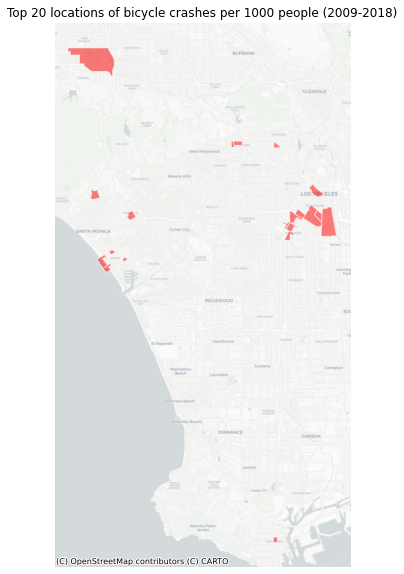

In [37]:
# map the top 20 geographies
fig,ax = plt.subplots(figsize=(12,10))
gdf_bg.sort_values(by='crashes_per_1000',ascending=False)[:20].plot(ax=ax,
                                                                 color='red',
                                                                 edgecolor='white',
                                                                 alpha=0.5,legend=True)


# title
ax.set_title('Top 20 locations of bicycle crashes per 1000 people (2009-2018)')

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

## Choropleth map of bike crashes

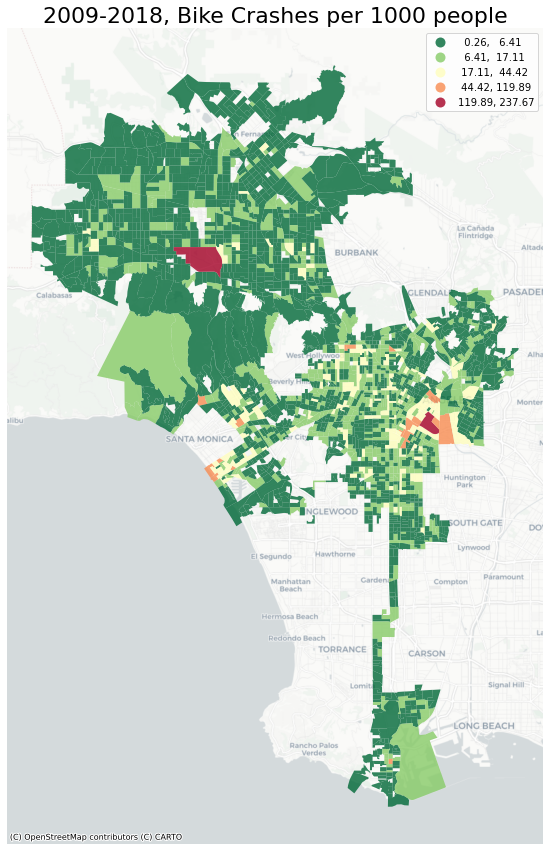

In [38]:
fig,ax = plt.subplots(figsize=(15,15))

gdf_bg.plot(ax=ax,
        column='crashes_per_1000',
        legend=True,
        alpha=0.8,
        cmap='RdYlGn_r',
        scheme='naturalbreaks')

ax.axis('off')
ax.set_title('2009-2018, Bike Crashes per 1000 people',fontsize=22)
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

<div class="alert alert-info">
The map above is a good way to begin exploring spatial patterns in our data. What does this map tell you? Is it informative? Do you notice any significant clusters? What if you change the map? Notice the `scheme` argument is set to `naturalbreaks`. Experiment with other map classfications such as `equalinterval`, `quantiles`. How does each classification change the map? 
</div>

# Global Spatial Autocorrelation

Similar to the Week 7 lab, we will use `k=8` for our KNN spatial weights and standardize our rows.

In [39]:
# calculate spatial weight
wq =  lps.weights.KNN.from_dataframe(gdf_bg,k=8)

# Row-standardization
wq.transform = 'r'

### Spatial lag

We found that the spatial lag is a great tool to help us understand our crash data since it more accurately gives us locations with high crash rates based on the surrounding area. The choropleth above (naturalbreaks) is too uniform while a choropleth with quantiles is too erratic and does not help us too much either.

In [40]:
# create a new column for the spatial lag
gdf_bg['crashes_per_1000_lag'] = lps.weights.lag_spatial(wq, gdf_bg['crashes_per_1000'])

In [41]:
# take a look at some sample rows
gdf_bg.sample(10)[['FIPS','TotalPop','crash_count','crashes_per_1000','crashes_per_1000_lag']]

,FIPS,TotalPop,crash_count,crashes_per_1000,crashes_per_1000_lag
222,060371154031,3583.0,11,3.070053,7.258976
1607,060372291002,2051.0,6,2.925402,5.441211
715,060371395041,2436.0,4,1.642036,2.235773
250,060371175302,3939.0,6,1.523229,3.481794
336,060371220003,1058.0,10,9.451796,2.848932
411,060371241042,605.0,12,19.834711,7.031349
2110,060372732004,1008.0,9,8.928571,26.602172
1670,060372326002,1957.0,11,5.620848,5.023580
2181,060372770002,764.0,1,1.308901,3.678166
2217,060372933011,3108.0,5,1.608752,2.807272


### The donut and the diamond

In [42]:
# create a column that calculates the difference betwen crashes and lag
gdf_bg['crash_lag_diff'] = gdf_bg['crashes_per_1000'] - gdf_bg['crashes_per_1000_lag']

In [43]:
# output to get the head and tail
gdf_bg.sort_values(by='crash_lag_diff')

,FIPS,TotalPop,geometry,crash_count,crashes_per_1000,crashes_per_1000_lag,crash_lag_diff
719,060371397012,1828.0,"MULTIPOLYGON (((-13190968.260 4049818.610, -13...",4,2.188184,33.546238,-31.358055
577,060371321013,1575.0,"MULTIPOLYGON (((-13191483.446 4054251.090, -13...",5,3.174603,33.811805,-30.637202
718,060371397011,934.0,"MULTIPOLYGON (((-13190022.935 4050952.298, -13...",4,4.282655,33.051250,-28.768595
694,060371390011,1621.0,"MULTIPOLYGON (((-13192453.484 4052500.119, -13...",6,3.701419,31.920860,-28.219441
2131,060372738003,416.0,"MULTIPOLYGON (((-13187166.365 4027320.929, -13...",2,4.807692,28.565852,-23.758159
...,...,...,...,...,...,...,...
2279,060372966002,608.0,"MULTIPOLYGON (((-13168242.942 3993414.950, -13...",44,72.368421,8.642465,63.725956
1556,060372260022,367.0,"MULTIPOLYGON (((-13163200.169 4033417.877, -13...",44,119.891008,50.677194,69.213814
1536,060372240201,961.0,"MULTIPOLYGON (((-13166257.559 4033229.280, -13...",94,97.814776,26.264425,71.550351
1555,060372260021,1453.0,"MULTIPOLYGON (((-13164628.510 4033003.746, -13...",267,183.757743,45.618938,138.138804


In [44]:
# the FIPS with highest negative difference
gdf_donut = gdf_bg.sort_values(by='crash_lag_diff').head(1)
gdf_donut

,FIPS,TotalPop,geometry,crash_count,crashes_per_1000,crashes_per_1000_lag,crash_lag_diff
719,060371397012,1828.0,"MULTIPOLYGON (((-13190968.260 4049818.610, -13...",4,2.188184,33.546238,-31.358055


In [45]:
# the FIPS with highest positive difference
gdf_diamond = gdf_bg.sort_values(by='crash_lag_diff').tail(1)
gdf_diamond

,FIPS,TotalPop,geometry,crash_count,crashes_per_1000,crashes_per_1000_lag,crash_lag_diff
2310,060379800241,223.0,"MULTIPOLYGON (((-13193418.068 4053521.172, -13...",53,237.668161,4.875866,232.792296


In [46]:
# set the mapbox access token
token = 'pk.eyJ1IjoieW9obWFuIiwiYSI6IkxuRThfNFkifQ.u2xRJMiChx914U7mOZMiZw'
px.set_mapbox_access_token(token)

In [47]:
# subset donut, project to WGS84, and get its centroid
gdf_donut = gdf_donut.to_crs('epsg:4326')

# what's the centroid?
minx, miny, maxx, maxy = gdf_donut.geometry.total_bounds
center_lat_donut = (maxy-miny)/2+miny
center_lon_donut = (maxx-minx)/2+minx

In [48]:
# subset diamond, project to WGS84, and get its centroid
gdf_diamond = gdf_diamond.to_crs('epsg:4326')

# what's the centroid?
minx, miny, maxx, maxy = gdf_diamond.geometry.total_bounds
center_lat_diamond = (maxy-miny)/2+miny
center_lon_diamond = (maxx-minx)/2+minx

# print it
print(center_lat_diamond)
print(center_lon_diamond)

34.1733255
-118.49300449999998


### Plotly's choropleth mapbox

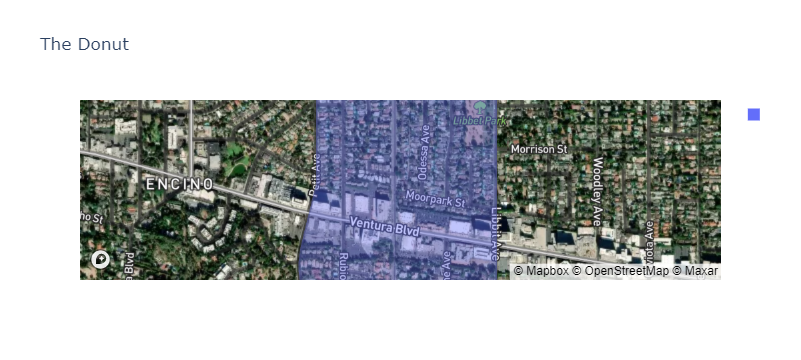

In [49]:
px.choropleth_mapbox(gdf_donut, 
                     geojson=gdf_donut.geometry, 
                     locations=gdf_donut.index, 
                     mapbox_style="satellite-streets",
                     zoom=14, 
                     center = {"lat": center_lat_donut, "lon": center_lon_donut},
                     hover_data=['FIPS','TotalPop','crash_count','crashes_per_1000','crashes_per_1000_lag'],
                     opacity=0.4,
                     title='The Donut')

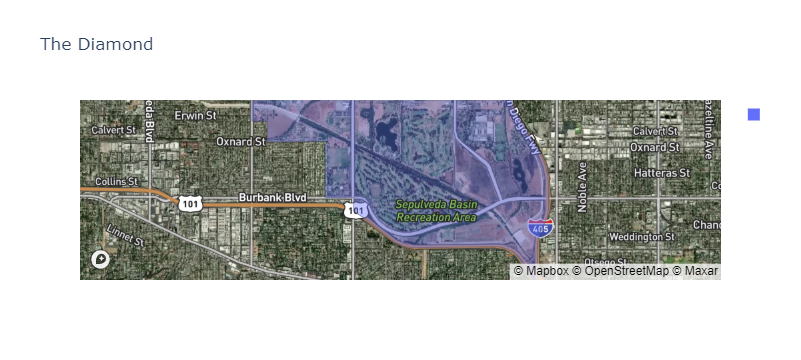

In [50]:
px.choropleth_mapbox(gdf_diamond, 
                     geojson=gdf_diamond.geometry, 
                     locations=gdf_diamond.index, 
                     mapbox_style="satellite-streets",
                     zoom=12, 
                     center = {"lat": center_lat_diamond, "lon": center_lon_diamond},
                     hover_data=['FIPS','TotalPop','crash_count','crashes_per_1000','crashes_per_1000_lag'],
                     opacity=0.4,
                     title='The Diamond')

## Spatial lag map

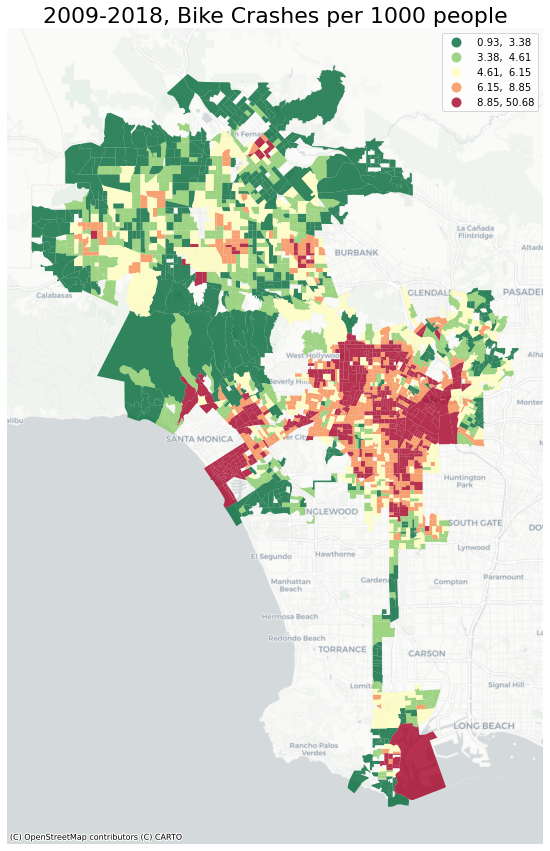

In [51]:
# use subplots that make it easier to create multiple layered maps
fig, ax = plt.subplots(figsize=(15, 15))

# spatial lag choropleth
gdf_bg.plot(ax=ax,
         figsize=(15,15),
         column='crashes_per_1000_lag',
         legend=True,
         alpha=0.8,
         cmap='RdYlGn_r',
         scheme='quantiles')

ax.axis('off')
ax.set_title('2009-2018, Bike Crashes per 1000 people',fontsize=22)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

## Side-by-side maps
We can now compare these two map outputs side by side. Notice that the syntax is a bit different from past labs where we have only worked with one figure at a time. This output produces 1 row, and 2 columns of figures in `subplots`.
- [subplots documentation](https://matplotlib.org/3.3.0/gallery/subplots_axes_and_figures/subplots_demo.html)

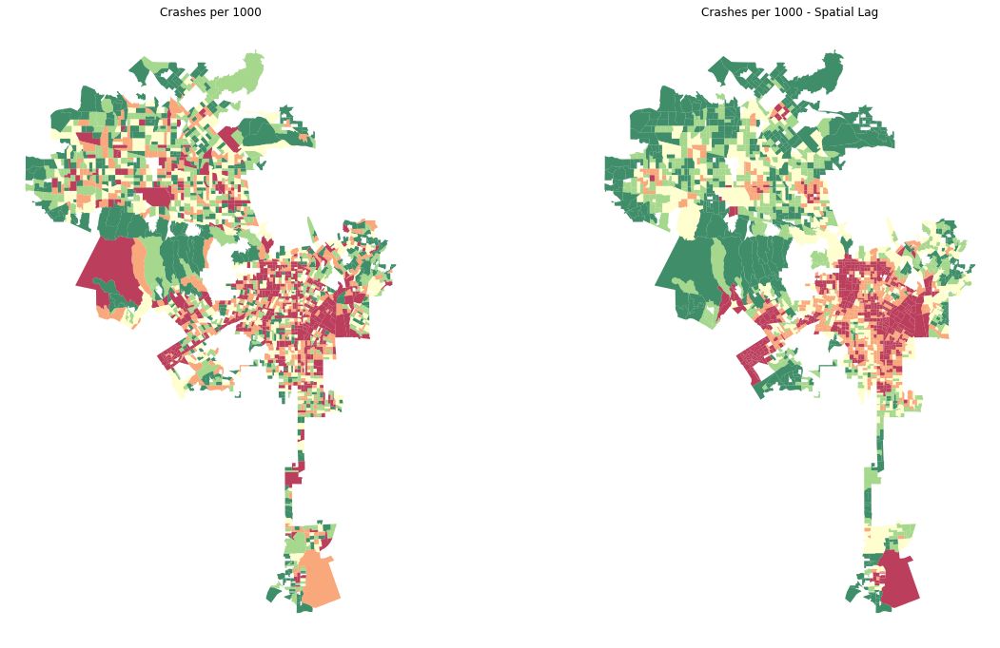

In [52]:
# create the 1x2 subplots
fig, ax = plt.subplots(1, 2, figsize=(20, 12))

# two subplots produces ax[0] (left) and ax[1] (right)

# regular count map on the left
gdf_bg.plot(ax=ax[0], # this assigns the map to the left subplot
         column='crashes_per_1000', 
         cmap='RdYlGn_r', 
         scheme='quantiles',
         k=5, 
         edgecolor='white', 
         linewidth=0, 
         alpha=0.75, 
           )


ax[0].axis("off")
ax[0].set_title("Crashes per 1000")

# spatial lag map on the right
gdf_bg.plot(ax=ax[1], # this assigns the map to the right subplot
         column='crashes_per_1000_lag', 
         cmap='RdYlGn_r', 
         scheme='quantiles',
         k=5, 
         edgecolor='white', 
         linewidth=0, 
         alpha=0.75
           )

ax[1].axis("off")
ax[1].set_title("Crashes per 1000 - Spatial Lag")

plt.show()

## Interactive spatial lag satellite map

In [53]:
# interactive version needs to be in WGS84
gdf_web = gdf_bg.to_crs('EPSG:4326')

In [54]:
# what's the centroid?
minx, miny, maxx, maxy = gdf_web.geometry.total_bounds
center_lat_gdf_web = (maxy-miny)/2+miny
center_lon_gdf_web = (maxx-minx)/2+minx

In [55]:
# some stats
gdf_web.crashes_per_1000_lag.describe()

count    2312.000000
mean        6.605794
std         4.813333
min         0.933844
25%         3.643684
50%         5.281155
75%         8.142047
max        50.677194
Name: crashes_per_1000_lag, dtype: float64

In [56]:
# grab the median
median = gdf_web.crashes_per_1000_lag.median()

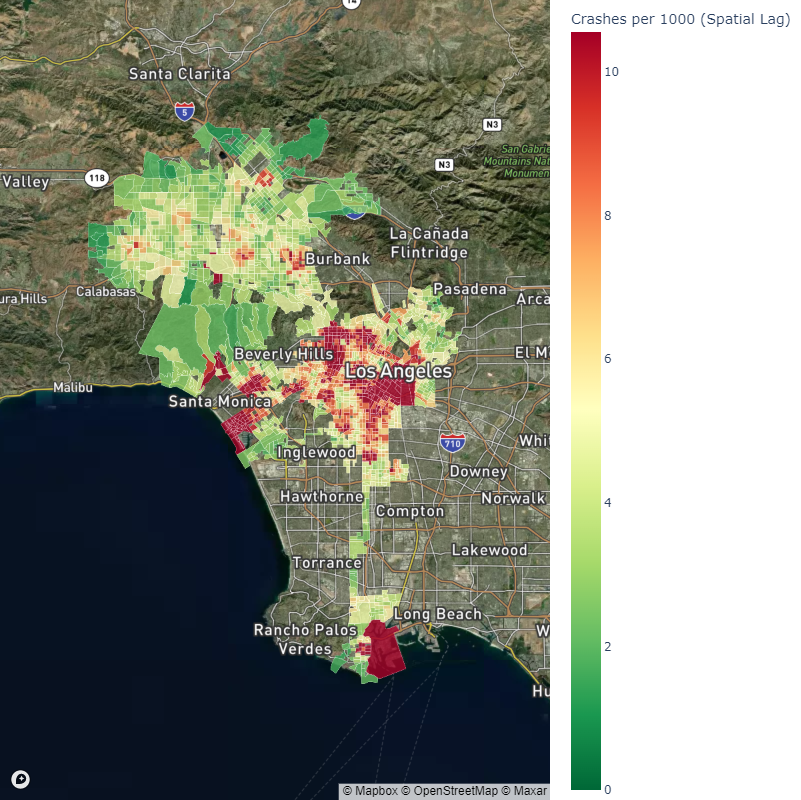

In [66]:
fig = px.choropleth_mapbox(gdf_web, 
                     geojson=gdf_web.geometry, # the geometry column
                     locations=gdf_web.index, # the index
                     mapbox_style="satellite-streets",
                     zoom=9, 
                     color='crashes_per_1000_lag',
                     color_continuous_scale='RdYlGn_r',
                     color_continuous_midpoint =median, # put the median as the midpoint
                     range_color =(0,median*2),
                     hover_data=['FIPS','TotalPop','crash_count','crashes_per_1000','crashes_per_1000_lag'],
                     center = {"lat": center_lat_gdf_web, "lon": center_lon_gdf_web},
                     opacity=0.8,
                     width=1000,
                     height=800,
                     labels={
                             'crashes_per_1000_lag':'Crashes per 1000 (Spatial Lag)',
                             'crashes_per_1000':'Crashes per 1000',
                     })
fig.update_traces(marker_line_width=0.1, marker_line_color='white')
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

In [67]:
fig.write_html("bikecollisions.html")

## Moran's Plot

In [58]:
y = gdf_bg.crashes_per_1000
moran = Moran(y, wq)
moran.I

0.2187426784237082

## Moran Scatterplot:

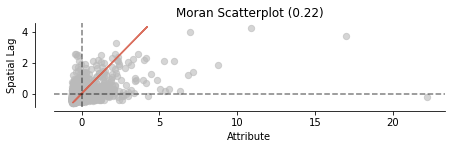

In [59]:
fig, ax = moran_scatterplot(moran, aspect_equal=True)
plt.show()

(<Figure size 504x504 with 1 Axes>,
 <AxesSubplot:title={'center':'Reference Distribution'}, xlabel='Moran I: 0.22', ylabel='Density'>)

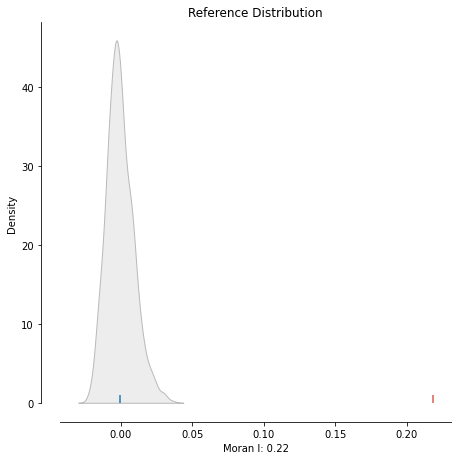

In [60]:
plot_moran_simulation(moran,aspect_equal=False)

We can compute the P-value:

<img src="https://www.simplypsychology.org/p-value.png" width=600>

In [61]:
moran.p_sim

0.001

# Local Spatial Autocorrelation

- HH: high crash rate geographies near other high crash rate neighbors
- LL: low crash rate geographies near other low arrest rate neighbors
- LH (donuts): low crash rate geographies surrounded by high crash rate neighbors
- HL (diamonds): high crash rate geographies surrounded by low crash rate neighbors

## Moran Local Scatterplot

In [62]:
# calculate local moran values
lisa = esda.moran.Moran_Local(y, wq)

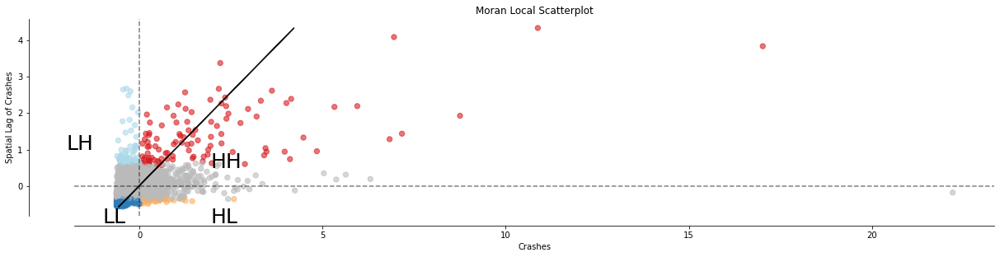

In [63]:
# Plot
fig,ax = plt.subplots(figsize=(20,15))

moran_scatterplot(lisa, ax=ax, p=0.05)
ax.set_xlabel("Crashes")
ax.set_ylabel('Spatial Lag of Crashes')

# add some labels
plt.text(1.95, 0.5, "HH", fontsize=25)
plt.text(1.95, -1, "HL", fontsize=25)
plt.text(-2, 1, "LH", fontsize=25)
plt.text(-1, -1, "LL", fontsize=25)
plt.show()

## Spatial Autocorrelation Map

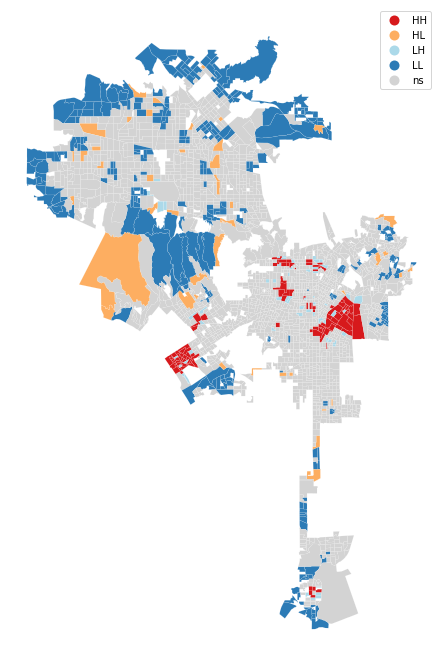

In [64]:
fig, ax = plt.subplots(figsize=(14,12))
lisa_cluster(lisa, gdf_bg, p=0.05, ax=ax)
plt.show()

### Creating a map comparing different p-values, .05 & .01

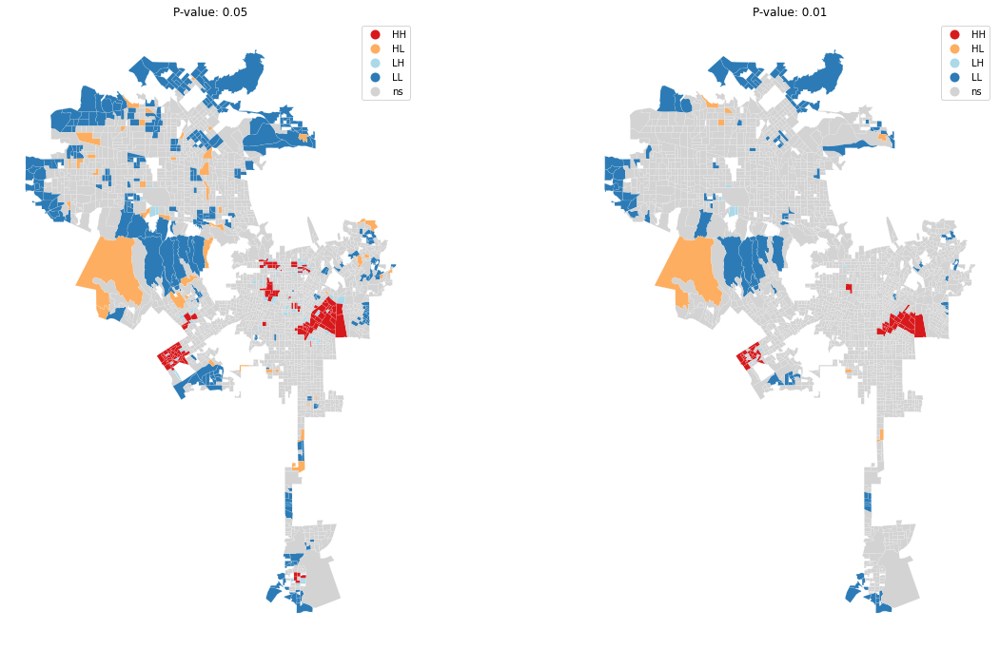

In [65]:
# create the 1x2 subplots
fig, ax = plt.subplots(1, 2, figsize=(20, 12))

# regular count map on the left
lisa_cluster(lisa, gdf_bg, p=0.05, ax=ax[0])

ax[0].axis("off")
ax[0].set_title("P-value: 0.05")

# spatial lag map on the right
lisa_cluster(lisa, gdf_bg, p=0.01, ax=ax[1])
ax[1].axis("off")
ax[1].set_title("P-value: 0.01")

plt.show()